# **📄 Document type classification EDA code**

## 1. Import Library & Define Functions
* EDA에 필요한 라이브러리를 로드합니다.
* EDA에 필요한 함수를 정의합니다.

In [90]:
import os
import time
import random

import albumentations as A
import pandas as pd
import numpy as np
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from tqdm import tqdm

In [91]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fe = fm.FontEntry(
    fname=r'../NanumBarunGothic.ttf',
    name='NanumBarunGothic')
fm.fontManager.ttflist.insert(0, fe)
plt.rcParams.update({'font.size': 10, 'font.family': 'NanumBarunGothic'})
plt.rc('font', family='NanumBarunGothic')
import seaborn as sns

## 2. Load Data

In [92]:
# data config
data_path = '../data'

In [120]:
train_df = pd.read_csv(os.path.join(data_path, 'train.csv'))
meta_df = pd.read_csv(os.path.join(data_path, 'meta.csv'))

## 3. 데이터 확인

### train

- ID: 학습 샘플의 파일명
- target: 학습 샘플의 정답 클래스 번호

In [17]:
print(f'train_df.shape: {train_df.shape}')

print('=== INFO ===')
print(train_df.info())

print('=== NUNIQUE ===')
print(train_df.nunique())

train_df.shape: (1570, 2)
=== INFO ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1570 entries, 0 to 1569
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   ID      1570 non-null   object
 1   target  1570 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 24.7+ KB
None
=== NUNIQUE ===
ID        1570
target      17
dtype: int64


### meta

- target: 17개의 클래스 번호
- class_name: 클래스 번호에 대응하는 클래스 이름

In [18]:
print(f'meta_df.shape: {meta_df.shape}')

print('=== INFO ===')
print(meta_df.info())

print('=== NUNIQUE ===')
print(meta_df.nunique())

meta_df.shape: (17, 2)
=== INFO ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   target      17 non-null     int64 
 1   class_name  17 non-null     object
dtypes: int64(1), object(1)
memory usage: 400.0+ bytes
None
=== NUNIQUE ===
target        17
class_name    17
dtype: int64


In [24]:
print(meta_df)

    target                                         class_name
0        0                                     account_number
1        1  application_for_payment_of_pregnancy_medical_e...
2        2                                      car_dashboard
3        3            confirmation_of_admission_and_discharge
4        4                                          diagnosis
5        5                                     driver_lisence
6        6                              medical_bill_receipts
7        7                     medical_outpatient_certificate
8        8                                   national_id_card
9        9                                           passport
10      10                               payment_confirmation
11      11                             pharmaceutical_receipt
12      12                                       prescription
13      13                                             resume
14      14                               statement_of_opinion
15      

#### 한글 class name 추가

In [112]:
meta_df['class_name_kr'] = ['계좌번호', 
                            '건강보험 임신출산 진료비 지급 신청서',
                            '자동차 계기판',
                            '입퇴원 확인서',
                            '진단서',
                            '운전면허증',
                            '진료비영수증',
                            '통원/진료 확인서',
                            '주민등록증',
                            '여권',
                            '진료비 납입 확인서',
                            '약제비 영수증',
                            '처방전',
                            '이력서',
                            '소견서',
                            '자동차 등록증', 
                            '자동차 번호판']

In [113]:
print(f'meta_df.shape: {meta_df.shape}')

print('=== INFO ===')
print(meta_df.info())

print('=== NUNIQUE ===')
print(meta_df.nunique())

meta_df.shape: (17, 3)
=== INFO ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17 entries, 0 to 16
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   target         17 non-null     int64 
 1   class_name     17 non-null     object
 2   class_name_kr  17 non-null     object
dtypes: int64(1), object(2)
memory usage: 536.0+ bytes
None
=== NUNIQUE ===
target           17
class_name       17
class_name_kr    17
dtype: int64


In [29]:
print(meta_df)

    target                                         class_name  \
0        0                                     account_number   
1        1  application_for_payment_of_pregnancy_medical_e...   
2        2                                      car_dashboard   
3        3            confirmation_of_admission_and_discharge   
4        4                                          diagnosis   
5        5                                     driver_lisence   
6        6                              medical_bill_receipts   
7        7                     medical_outpatient_certificate   
8        8                                   national_id_card   
9        9                                           passport   
10      10                               payment_confirmation   
11      11                             pharmaceutical_receipt   
12      12                                       prescription   
13      13                                             resume   
14      14               

## 3. EDA

### target count 확인

In [121]:
train_df['target'].value_counts()

target
16    100
10    100
0     100
3     100
12    100
8     100
2     100
11    100
7     100
9     100
15    100
5     100
4     100
6     100
13     74
14     50
1      46
Name: count, dtype: int64

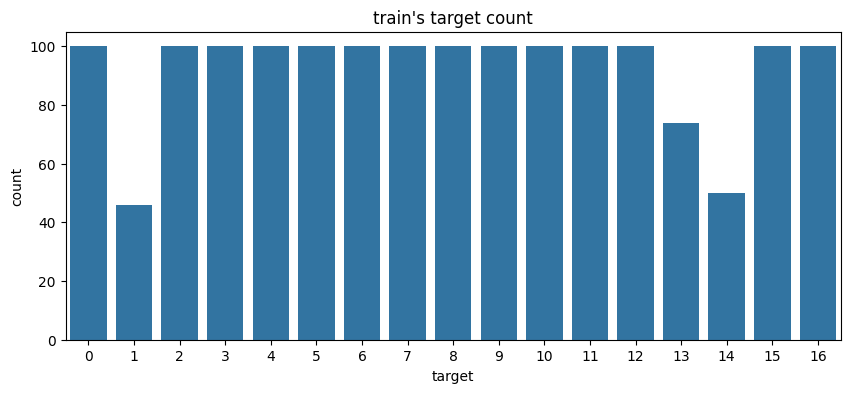

In [66]:
plt.figure(figsize=(10, 4))
plt.title(label="train's target count", loc='center')
sns.barplot(train_df['target'].value_counts())
plt.show()

In [65]:
meta_df.loc[(meta_df['target'] == 1) | (meta_df['target'] == 13) | (meta_df['target'] == 14)]

,target,class_name,class_name_kr
1,1,application_for_payment_of_pregnancy_medical_e...,건강보험 임신출산 진료비 지급 신청서
13,13,resume,이력서
14,14,statement_of_opinion,소견서


### 검증

In [68]:
train_meta_df = pd.merge(left=train_df, right=meta_df, on='target', how='left').drop(columns='class_name')

print(f'train_meta_df.shape: {train_meta_df.shape}')

print('=== INFO ===')
print(train_meta_df.info())

print('=== NUNIQUE ===')
print(train_meta_df.nunique())

train_meta_df.shape: (1570, 3)
=== INFO ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1570 entries, 0 to 1569
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   ID             1570 non-null   object
 1   target         1570 non-null   int64 
 2   class_name_kr  1570 non-null   object
dtypes: int64(1), object(2)
memory usage: 36.9+ KB
None
=== NUNIQUE ===
ID               1570
target             17
class_name_kr      17
dtype: int64


In [ ]:
train_meta_df['file_path'] = data_path + '/' + 'train/' + train_meta_df['ID']

In [5]:
train_meta_df['file_path'].head()

0    ../data//train/002f99746285dfdd.jpg
1    ../data//train/008ccd231e1fea5d.jpg
2    ../data//train/008f5911bfda7695.jpg
3    ../data//train/009235e4c9c07af5.jpg
4    ../data//train/00b2f44967580c74.jpg
Name: file_path, dtype: object

In [4]:
print(f'train_meta_df.shape: {train_meta_df.shape}')

print('=== INFO ===')
print(train_meta_df.info())

print('=== NUNIQUE ===')
print(train_meta_df.nunique())

train_meta_df.shape: (1570, 4)
=== INFO ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1570 entries, 0 to 1569
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   ID             1570 non-null   object
 1   target         1570 non-null   int64 
 2   class_name_kr  1570 non-null   object
 3   file_path      1570 non-null   object
dtypes: int64(1), object(3)
memory usage: 49.2+ KB
None
=== NUNIQUE ===
ID               1570
target             17
class_name_kr      17
file_path        1570
dtype: int64


In [21]:
def get_image_info(index):
    return train_meta_df.loc[index, 'class_name_kr'] , Image.open(train_meta_df.loc[index, 'file_path'])

In [88]:
matrix_w = 5
matrix_size = matrix_w**2

def verify_image_label(start, end):
    for start_index in np.arange(start, end, matrix_size):
        end_index = start_index + matrix_size
        if end_index > end:
            end_index = end

        plt.figure(figsize=(12, 16))

        for n, index in enumerate(np.arange(start_index, end_index), start=1):
            plt.subplot(matrix_w, matrix_w, n)
            label, img = get_image_info(index)
            plt.imshow(img)
            plt.title(f'{index}, {label}')
            plt.axis('off')

        plt.suptitle(f'Train Dataset {start_index} ~ {end_index-1}')
        plt.tight_layout()
        plt.show()    

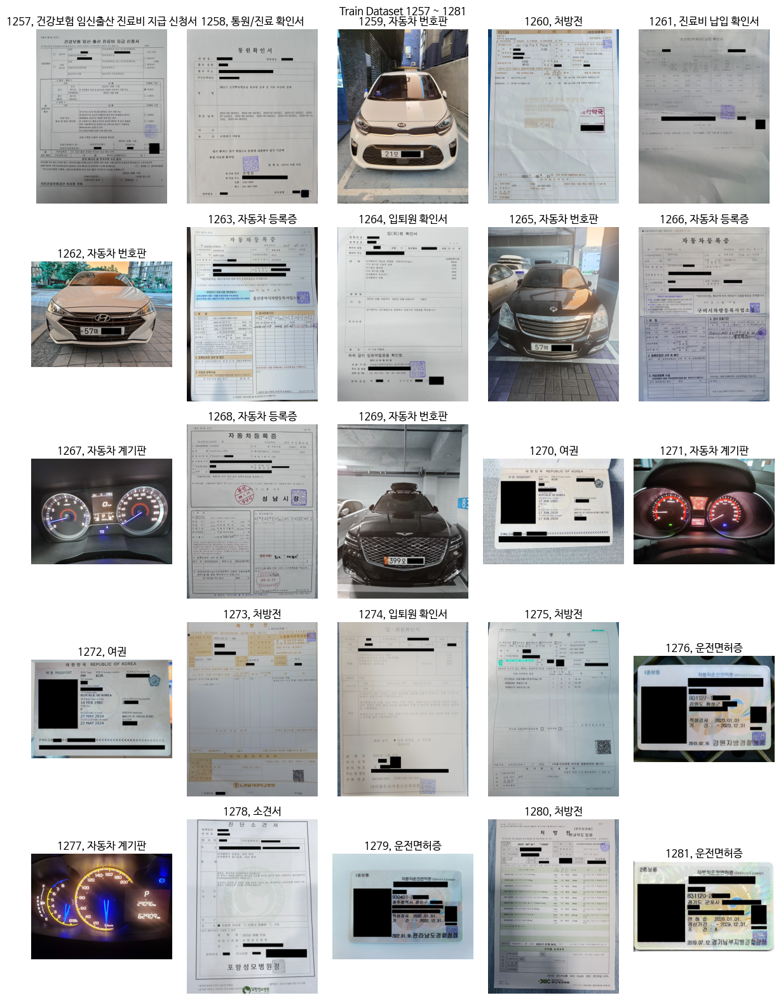

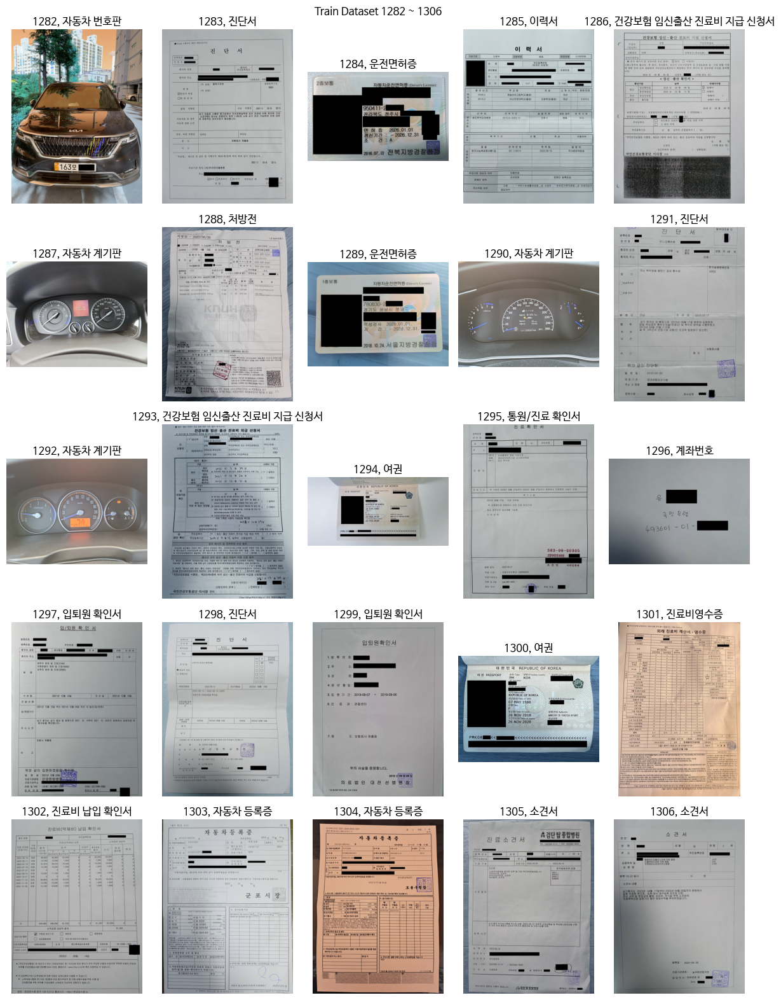

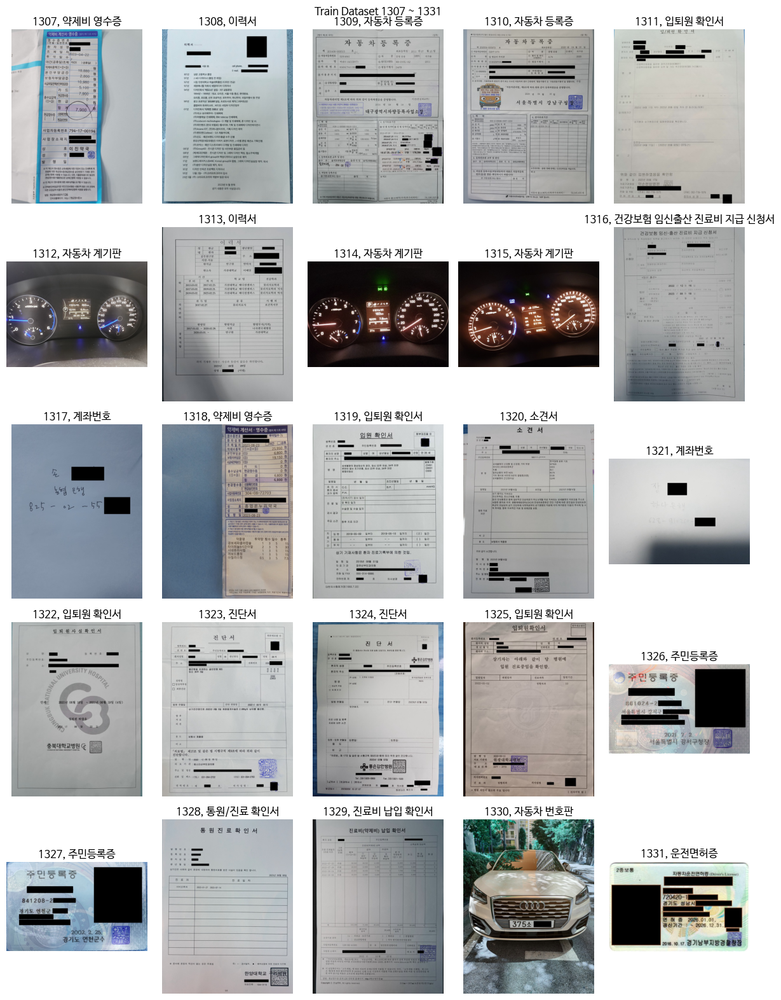

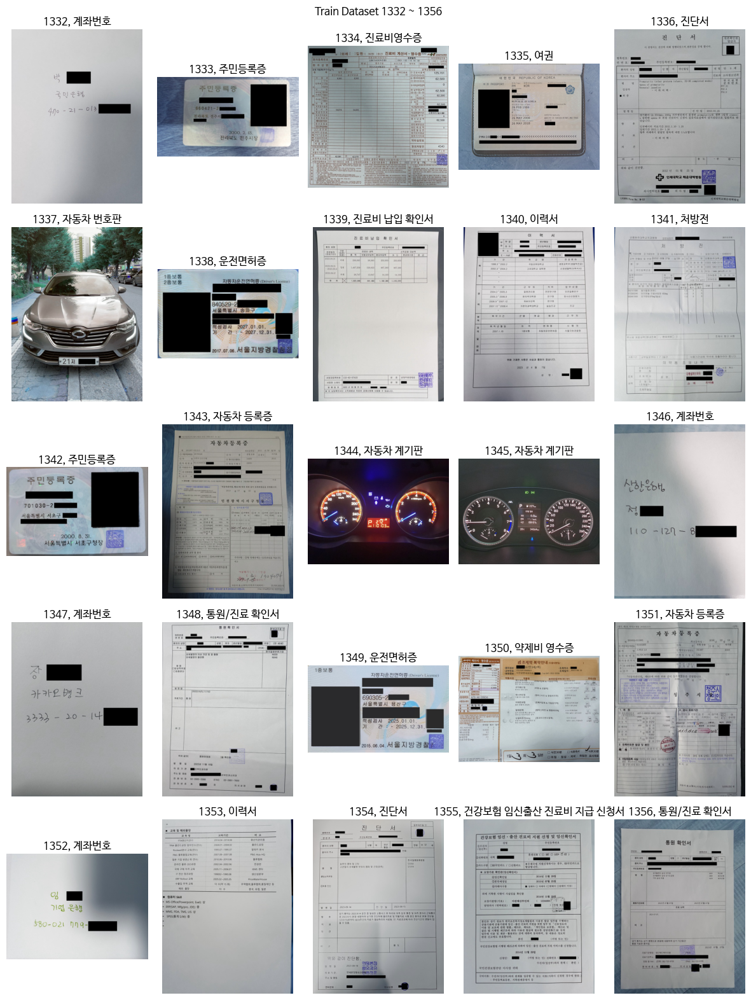

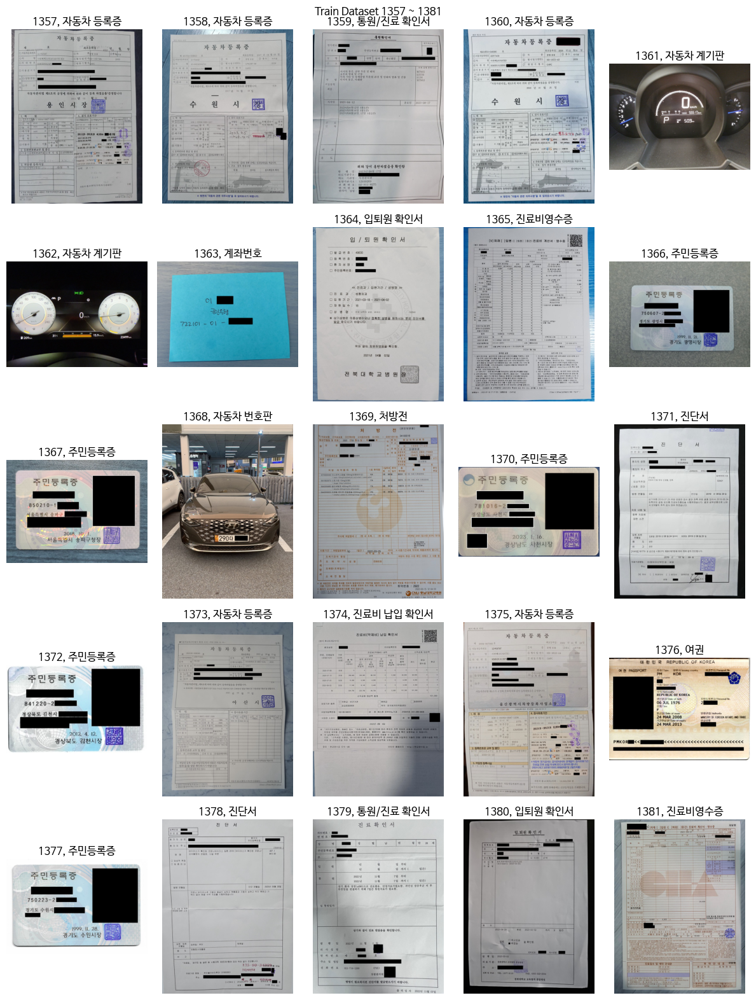

...

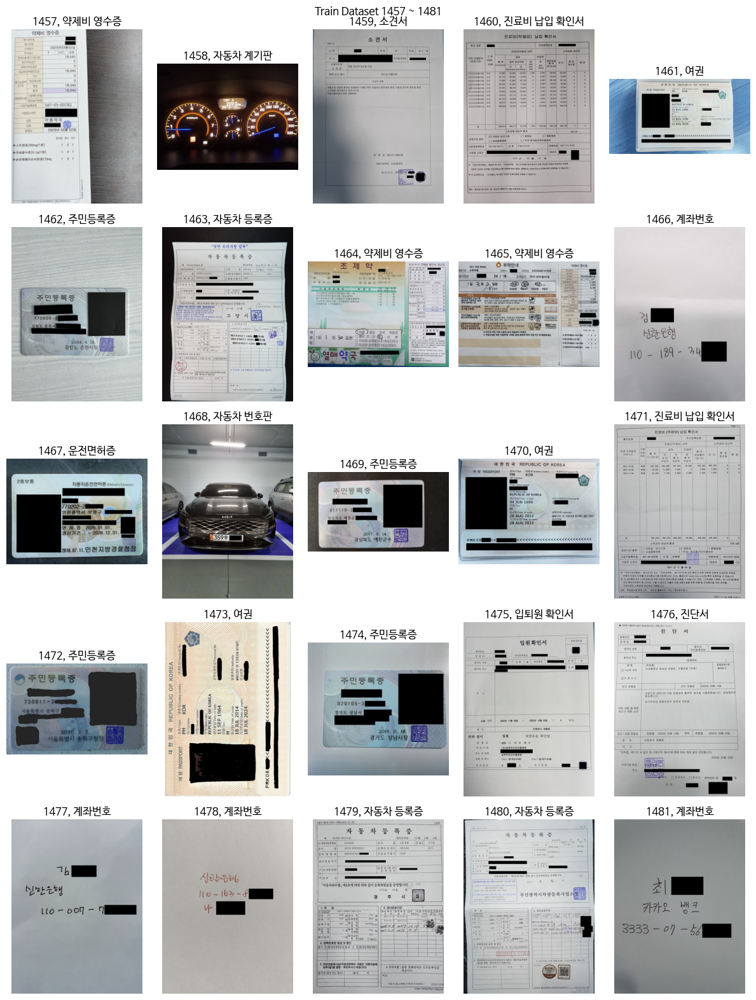

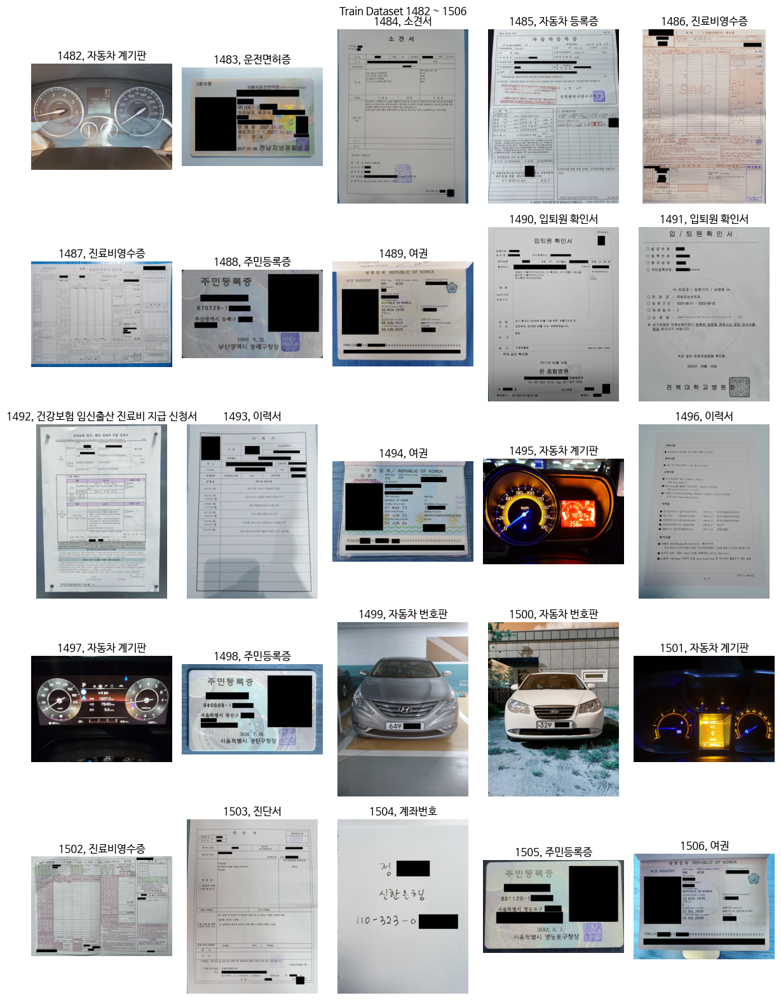

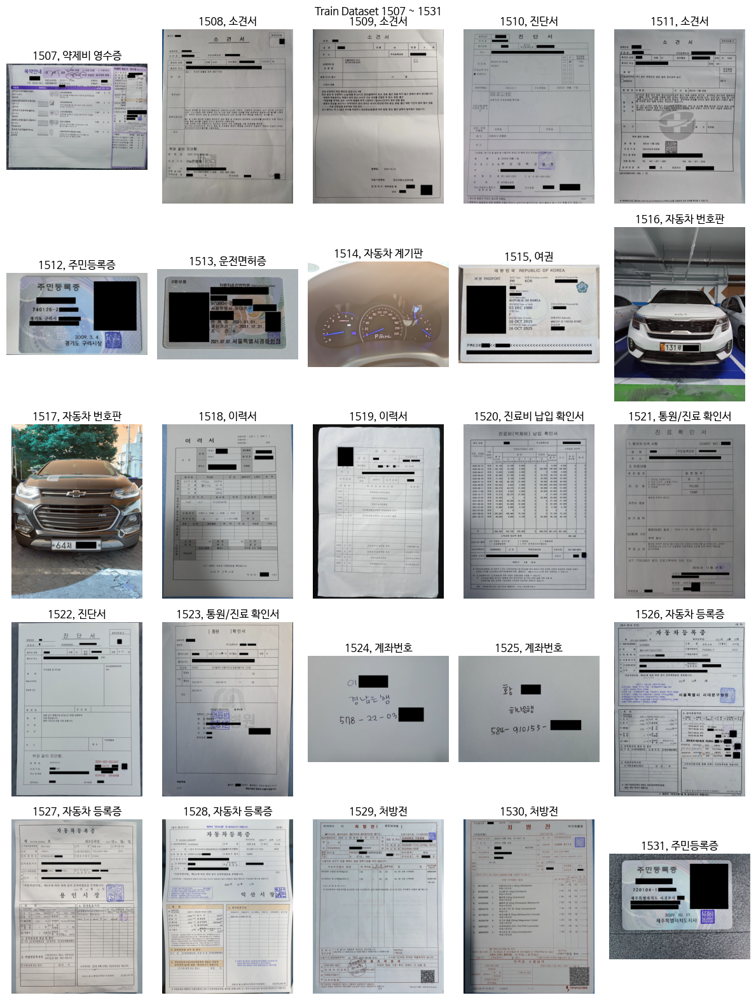

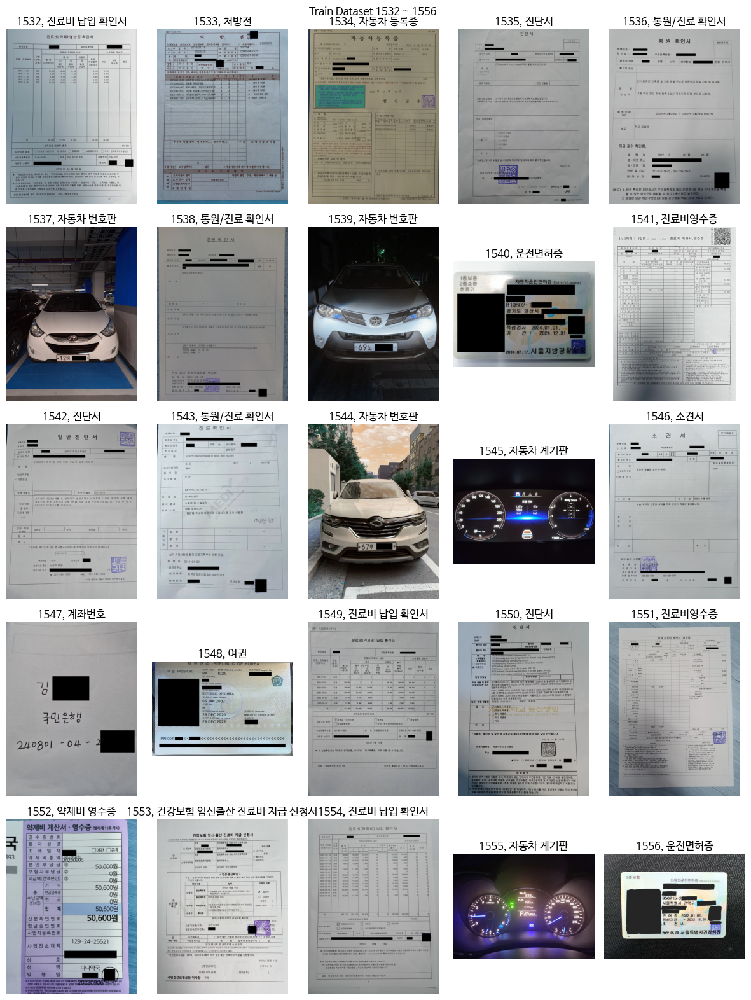

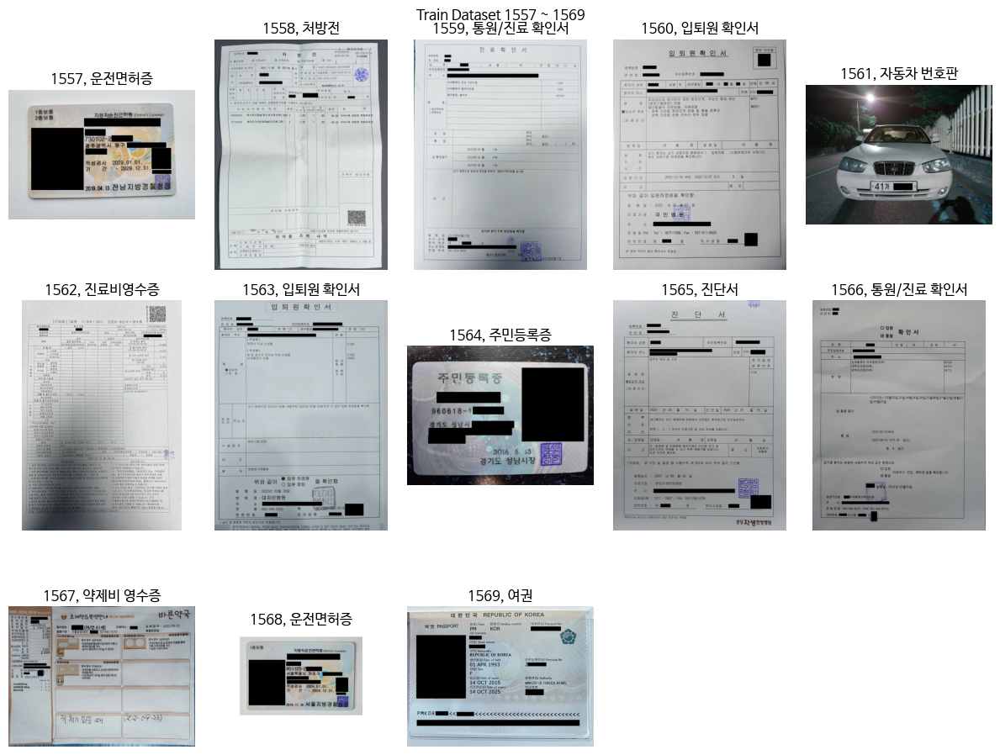

In [89]:
verify_image_label(start = 1257, end = 1570)

### incorrect label 수정

In [97]:
incorrect_label_list = ['45f0d2dfc7e47c03.jpg', 'aec62dced7af97cd.jpg', '8646f2c3280a4f49.jpg', 
 '1ec14a14bbe633db.jpg', '7100c5c67aecadc5.jpg', 'c5182ab809478f12.jpg',
 '38d1796b6ad99ddd.jpg', '0583254a73b48ece.jpg']

In [99]:
my_role_data = train_meta_df.loc[1257:, 'ID']
my_role_data[my_role_data.isin(incorrect_label_list)]

Series([], Name: ID, dtype: object)

In [100]:
train_meta_df.loc[train_meta_df['ID'].isin(incorrect_label_list)]

,ID,target,class_name_kr,file_path
38,0583254a73b48ece.jpg,11,약제비 영수증,../data//train/0583254a73b48ece.jpg
192,1ec14a14bbe633db.jpg,14,소견서,../data//train/1ec14a14bbe633db.jpg
340,38d1796b6ad99ddd.jpg,11,약제비 영수증,../data//train/38d1796b6ad99ddd.jpg
428,45f0d2dfc7e47c03.jpg,3,입퇴원 확인서,../data//train/45f0d2dfc7e47c03.jpg
723,7100c5c67aecadc5.jpg,3,입퇴원 확인서,../data//train/7100c5c67aecadc5.jpg
862,8646f2c3280a4f49.jpg,7,통원/진료 확인서,../data//train/8646f2c3280a4f49.jpg
1095,aec62dced7af97cd.jpg,3,입퇴원 확인서,../data//train/aec62dced7af97cd.jpg
1237,c5182ab809478f12.jpg,4,진단서,../data//train/c5182ab809478f12.jpg


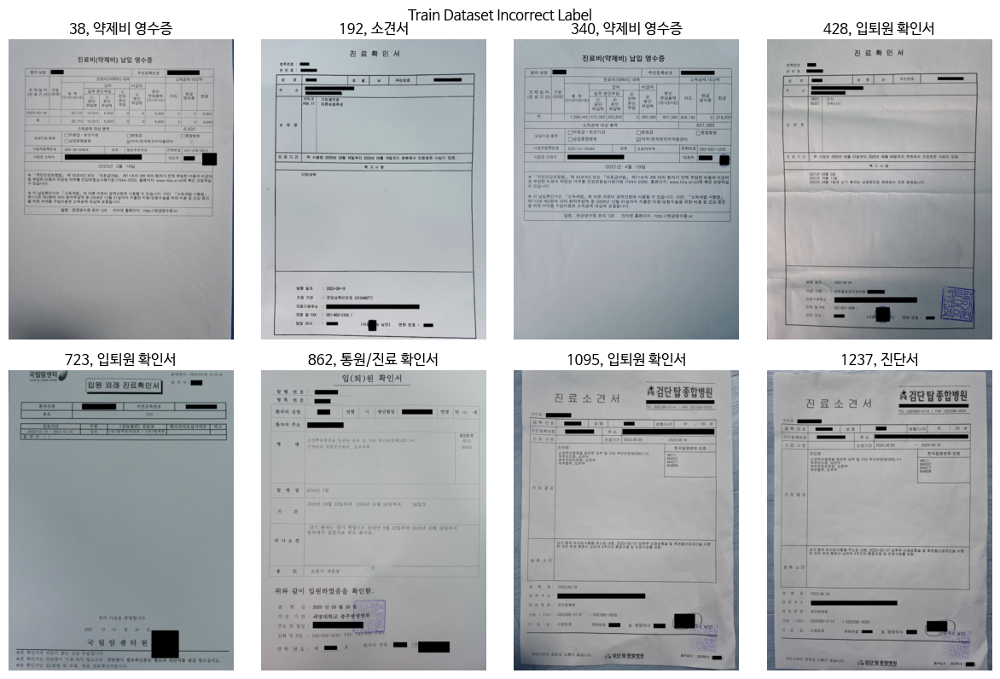

In [115]:
plt.figure(figsize=(12, 16))

for n, index in enumerate(train_meta_df.loc[train_meta_df['ID'].isin(incorrect_label_list)].index, start=1):
    plt.subplot(4, 4, n)
    label, img = get_image_info(index)
    plt.imshow(img)
    plt.title(f'{index}, {label}')
    plt.axis('off')

plt.suptitle(f'Train Dataset Incorrect Label')
plt.tight_layout()
plt.show()    

In [114]:
meta_df

,target,class_name,class_name_kr
0,0,account_number,계좌번호
1,1,application_for_payment_of_pregnancy_medical_e...,건강보험 임신출산 진료비 지급 신청서
2,2,car_dashboard,자동차 계기판
3,3,confirmation_of_admission_and_discharge,입퇴원 확인서
4,4,diagnosis,진단서
5,5,driver_lisence,운전면허증
6,6,medical_bill_receipts,진료비영수증
7,7,medical_outpatient_certificate,통원/진료 확인서
8,8,national_id_card,주민등록증
9,9,passport,여권


In [128]:
train_correct_label_df = train_df.copy()

# 약제비 영수증 > 진료비 납입 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '0583254a73b48ece.jpg', 'target'] = 10
# 소견서 > 통원/진료 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '1ec14a14bbe633db.jpg', 'target'] = 7
# 약제비 영수증 > 진료비 납입 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '38d1796b6ad99ddd.jpg', 'target'] = 10
# 입퇴원 확인서 > 통원/진료 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '45f0d2dfc7e47c03.jpg', 'target'] = 7
# 입퇴원 확인서 > 통원/진료 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '7100c5c67aecadc5.jpg', 'target'] = 7
# 통원/진료 확인서 > 입퇴원 확인서
train_correct_label_df.loc[train_correct_label_df['ID'] == '8646f2c3280a4f49.jpg', 'target'] = 3
# 입퇴원 확인서 > 소견서
train_correct_label_df.loc[train_correct_label_df['ID'] == 'aec62dced7af97cd.jpg', 'target'] = 14
# 진단서 > 소견서
train_correct_label_df.loc[train_correct_label_df['ID'] == 'c5182ab809478f12.jpg', 'target'] = 14

In [129]:
train_correct_label_df['target'].value_counts()

target
7     102
10    102
0     100
12    100
8     100
2     100
16    100
9     100
15    100
5     100
6     100
4      99
11     98
3      98
13     74
14     51
1      46
Name: count, dtype: int64

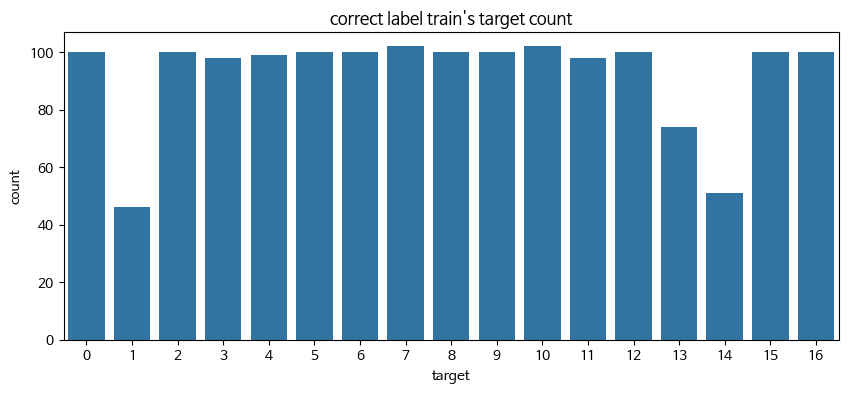

In [130]:
plt.figure(figsize=(10, 4))
plt.title(label="correct label train's target count", loc='center')
sns.barplot(train_correct_label_df['target'].value_counts())
plt.show()

In [132]:
train_correct_label_df.to_csv(os.path.join(data_path, 'train_correct_labeling.csv'), index=False)